<a href="https://colab.research.google.com/github/chipzm/NUIG_Thesis/blob/main/Test%201.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -q super-gradients

In [ ]:
import glob
import os
import shutil
import json
import random
import numpy as np
import tqdm
import math
import sys

from pycocotools.coco import COCO

In [ ]:
from PIL import Image
import os
import numpy as np
import torch

import random
import pathlib
import requests

from torch.utils.data import Dataset
import json
from torchvision import transforms, utils

from pathlib import Path
import cv2
import matplotlib.pyplot as plt

from super_gradients.training import Trainer, dataloaders, models
from super_gradients.training.dataloaders.dataloaders import coco_detection_yolo_format_train, coco_detection_yolo_format_val
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050
from super_gradients.training.models.detection_models.pp_yolo_e import PPYoloEPostPredictionCallback

The console stream is logged into /root/sg_logs/console.log


[2023-08-28 08:35:50] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it
[2023-08-28 08:35:53] WARNING - __init__.py - Failed to import pytorch_quantization
[2023-08-28 08:36:03] INFO - utils.py - NumExpr defaulting to 2 threads.
/usr/local/lib/python3.10/dist-packages/_distutils_hack/__init__.py:33: UserWarning: Setuptools is replacing distutils.
  warnings.warn("Setuptools is replacing distutils.")
[2023-08-28 08:36:04] WARNING - calibrator.py - Failed to import pytorch_quantization
[2023-08-28 08:36:04] WARNING - export.py - Failed to import pytorch_quantization
[2023-08-28 08:36:04] WARNING - selective_quantization_utils.py - Failed to import pytorch_quantization


In [ ]:
# Analyze training metrics
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/kaggle_animal_chkpt/kaggle_animal_ds

<IPython.core.display.Javascript object>

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
model_name = 'yolo_nas_l'
num_classes = 81
checkpoint_path = '/content/drive/MyDrive/kaggle_animal_chkpt/kaggle_animal_ds/average_model.pth'


# the best model
best_model = models.get('yolo_nas_l',
                        num_classes=81,
                        checkpoint_path='/content/drive/MyDrive/kaggle_animal_chkpt/kaggle_animal_ds/average_model.pth')

[2023-08-28 05:12:05] INFO - checkpoint_utils.py - Successfully loaded model weights from /content/drive/MyDrive/kaggle_animal_chkpt/kaggle_animal_ds/average_model.pth EMA checkpoint.


/usr/local/lib/python3.10/dist-packages/torch/amp/autocast_mode.py:204: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn('User provided device_type of \'cuda\', but CUDA is not available. Disabling')
[2023-08-28 05:12:26] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


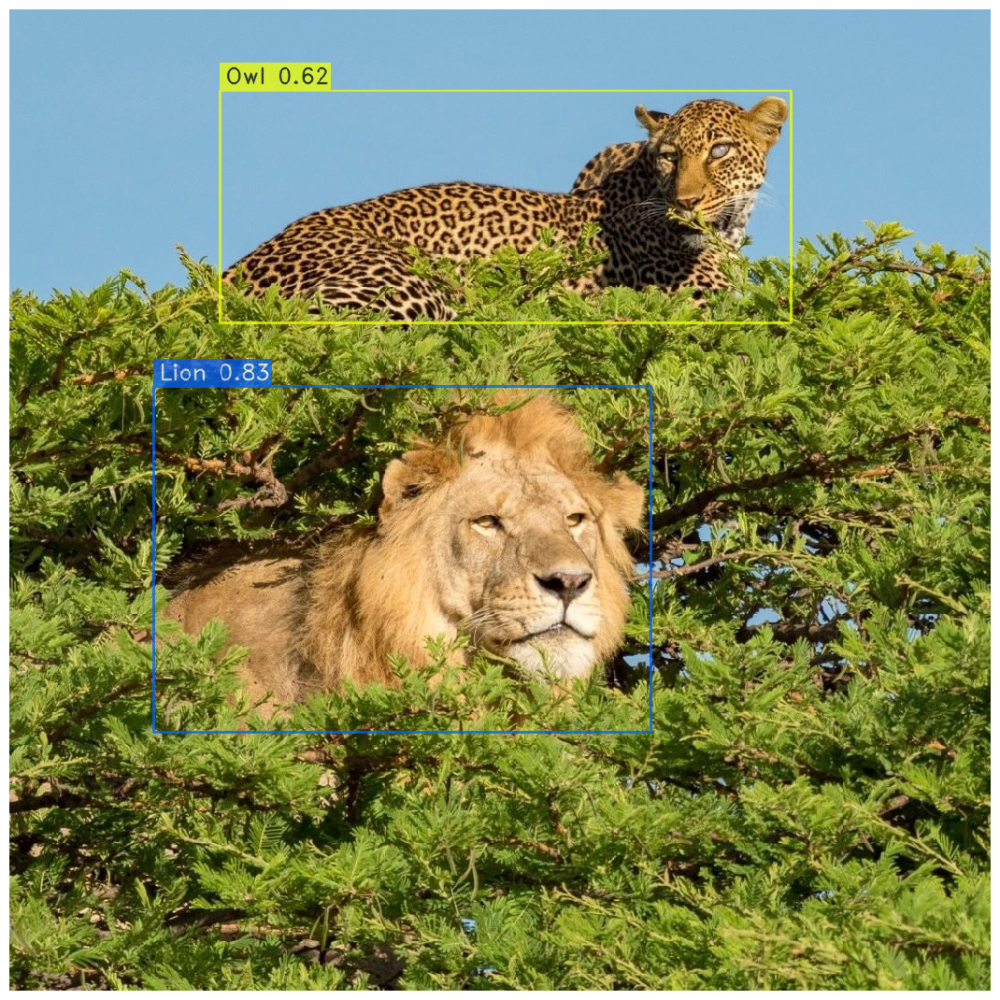

In [ ]:
# Predicting new data with 20 epochs
url = 'https://i.pinimg.com/1200x/da/8f/72/da8f729a05ad064830f30cc757d2d277.jpg'
# 'https://cdn.britannica.com/40/146340-050-297B2798/Leopard-tree-Kenya-Masai-Mara-National-Reserve.jpg'
# fig = '/content/n02085620_326.jpg'
best_model.predict(url).show()

/usr/local/lib/python3.10/dist-packages/torch/amp/autocast_mode.py:204: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn('User provided device_type of \'cuda\', but CUDA is not available. Disabling')
[2023-08-28 06:09:02] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


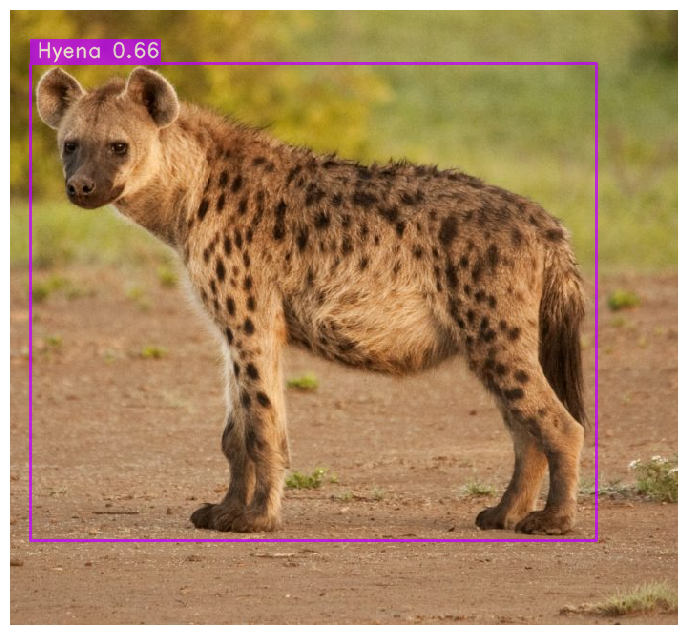

NoneType

In [ ]:
best_model.predict('/content/spotted_hyena.jpg')

[2023-08-28 05:58:02] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


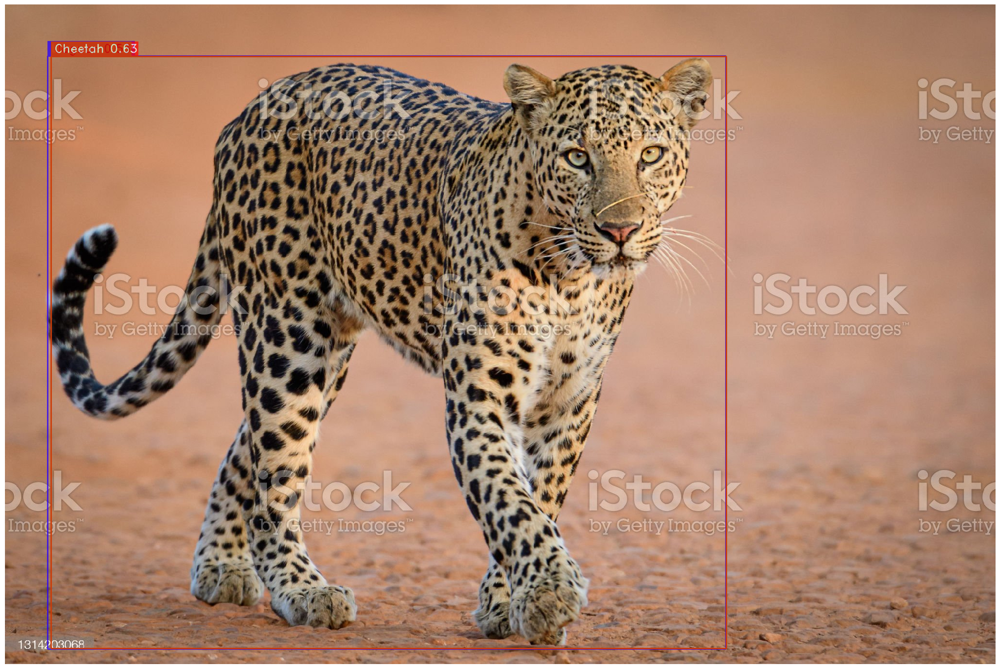

In [ ]:
best_model.predict('/content/leopard2.jpg').show()

[2023-08-28 06:19:35] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


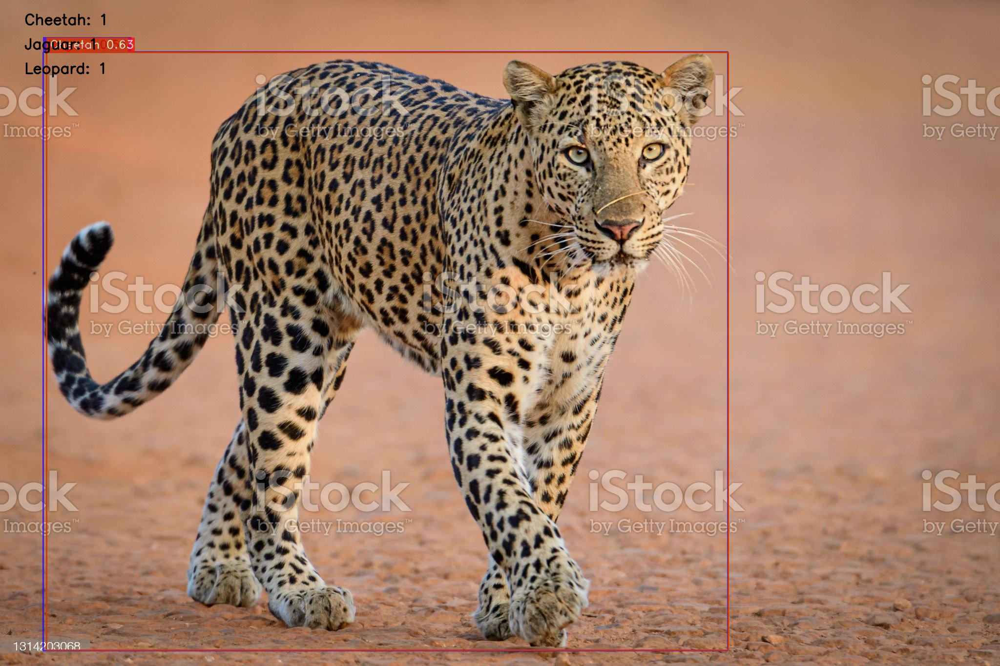

In [ ]:
# Saving the predicted image and gathering the details required
from collections import Counter
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
%matplotlib inline

from google.colab.patches import cv2_imshow

pred = best_model.predict('/content/leopard2.jpg')
# saving the predicted image
pred.save(output_folder="/content/output")

result = list(pred)[0]

class_names = list(result.class_names)

counter = Counter(list(result.prediction.labels.astype("int")))
output = list(counter.items())
output = list(map(lambda x: (class_names[x[0]],x[1]),output))

path = r'/content/output/pred_0.jpg'
image = cv2.imread(path)

# font = cv2.FONT_HERSHEY_SIMPLEX
# # org
# org = (50, 50)
# # fontScale
# fontScale = 1
# # Blue color in BGR
# color = (0,0,255)
# # Line thickness of 2 px
# thickness = 2


for i in range(len(output)):
  # Using cv2.putText() method
  org = (50, 50*i+50)
  image = cv2.putText(image, str(output[i][0]) + ': '+ str(output[i][1]), org, cv2.FONT_HERSHEY_SIMPLEX, 1, (0,0,0), 2, cv2.LINE_AA)

cv2_imshow(image)

In [ ]:
# predicting for videos
best_model.predict('/content/bear_1.mp4',  conf=0.50).save('bear_detections.mp4')

In [ ]:
!pip install -q filterpy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.0/178.0 kB 3.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [ ]:
import sys

sys.path.append('/content/drive/MyDrive/')
from sort_orig import *

In [ ]:
cap = cv2.VideoCapture('/content/bear_1.mp4')

frame_width = int(cap.get(3))
frame_height = int(cap.get(4))

device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device('cpu')

In [ ]:
import math

classnames = ['Leopard', 'Turkey', 'Horse', 'Jellyfish', 'Polar bear', 'Rhinoceros', 'Chicken', 'Tiger', 'Lion', 'Sea turtle', 'Kangaroo', 'Deer',
              'Bear', 'Bull', 'Elephant', 'Scorpion', 'Brown bear', 'Snail', 'Butterfly', 'Turtle', 'Caterpillar', 'Goldfish', 'Sheep', 'Goose',
              'Magpie', 'Mule', 'Worm', 'Squid', 'Otter', 'Crab', 'Jaguar', 'Frog', 'Penguin', 'Starfish', 'Hippopotamus', 'Koala', 'Monkey',
              'Camel', 'Canary', 'Rabbit', 'Parrot', 'Swan', 'Shrimp', 'Whale', 'Duck', 'Moths and butterflies', 'Owl', 'Crocodile', 'Fox',
              'Woodpecker', 'Hamster', 'Seahorse', 'Squirrel', 'Goat', 'Shark', 'Giraffe', 'Red panda', 'Hedgehog', 'Raccoon', 'Zebra', 'Eagle',
              'Cheetah', 'Tick', 'Snake', 'Mouse', 'Tortoise', 'Ostrich', 'Raven', 'Sparrow', 'Harbor seal', 'Centipede', 'Pig', 'Fish', 'Panda',
              'Lizard', 'Cattle', 'Sea lion', 'Ladybug', 'Spider', 'Lynx', 'Hyena']

out = cv2.VideoWriter('bear_tracker1.mp4', cv2.VideoWriter_fourcc('M', 'J', 'P', 'G'), 10, (frame_width, frame_height))

tracker = Sort(max_age = 20, min_hits = 3, iou_threshold = 0.3)

limitup = [500, 2, 500, 699]
counter = set()

while True:
  ret, frame = cap.read()
  # count +=1
  if ret:
    detections = np.empty((0,5))
    result = list(best_model.predict(frame, conf = 0.35))[0]
    bbox_xyxys = result.prediction.bboxes_xyxy.tolist()
    confidences = result.prediction.confidence
    labels = result.prediction.labels.tolist()
    for (bbox_xyxy, confidence, cls) in zip(bbox_xyxys, confidences, labels):
      bbox = np.array(bbox_xyxy)
      x1, y1, x2, y2 = bbox[0], bbox[1], bbox[2], bbox[3]
      x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)
      classname = int(cls)
      class_name = classnames[classname]
      conf = math.ceil((confidence*100))/100

      currentArray = np.array([x1, y1, x2, y2, conf])
      detections = np.vstack((detections, currentArray))

    result_tracker = tracker.update(detections)
    cv2.line(frame, (limitup[0], limitup[1]), (limitup[2], limitup[3]), (0, 0, 255), 2)
    # cv2.line(frame, (limitdown[0], limitdown[1]), (limitdown[2], limitdown[3]), (0, 0, 255), 2)
    # cv2.polylines(frame, [np.array(limitup, np.int32)], True, (0, 0, 255), 3)

    class_names1 = list(result.class_names)

    counter1 = Counter(list(result.prediction.labels.astype("int")))
    output = list(counter1.items())
    output = list(map(lambda x: (class_names1[x[0]],x[1]),output))

    for i in range(len(output)):
      # Using cv2.putText() method
      org = (frame_width-300, 50*i+100)
      cv2.putText(frame, str(output[i][0]) + ': '+ str(output[i][1]), org, cv2.FONT_HERSHEY_SIMPLEX, fontScale=1, color=(0, 0, 0), thickness =2, lineType = cv2.LINE_AA)


    for result in result_tracker:
      x1, y1, x2, y2, id = result
      x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)
      cx, cy = int((x1+x2)/2), int((y1+y2)/2)
      # print(cx, cy)
      cv2.circle(frame, (cx, cy), 2, (255, 0, 243), cv2.FILLED) #to give color and display the center points of the objects
      cv2.rectangle(frame, (x1, y1), (x2, y2), (45, 210, 255), 2) #creating bounding boxes over the objects with thickness 3
      label = f'{int(id)}{class_name}'#to dsplay the classname and the unique tracker id
      txt_size = cv2.getTextSize(label, 0, fontScale = 1, thickness = 1)[0]
      c2 = x1 + txt_size[0], y1 - txt_size[1] - 3
      cv2.rectangle(frame, (x1, y1), c2, (255, 0, 0), -1, cv2.LINE_AA)
      cv2.putText(frame, label, (x1, y1-2), 0, 0.6, (0, 255, 0), thickness = 1, lineType = cv2.LINE_AA)

      # counter.add(id)

      if limitup[0] == cx == limitup[2] and limitup[1] < cy < limitup[3]:
        counter.add(id)
        cv2.line(frame, (limitup[0], limitup[1]), (limitup[2], limitup[3]), (0, 255, 0), 2) #whnever the object passes through this line, the color of the line changes

    cv2.putText(frame, 'No of Animals: ' + str(len(counter)), (50, 100), cv2.FONT_HERSHEY_SIMPLEX, 1, (0,0,0), 2, lineType = cv2.LINE_AA)
    # resize_frame = cv2.resize(frame, (0,0), fx = 0.2, fy = 0.2, interpolation = cv2.INTER_AREA)
    # print(counter)
    out.write(frame)
    cv2_imshow(frame)

    if cv2.waitKey(1) & 0xFF == ord('1'):
      break
  else:
    break

out.release()
cap.release()
cv2.destroyAllWindows()

# Getting the best model for kaggle_edited data


In [ ]:
# the best model
best_model = models.get('yolo_nas_l',
                        num_classes=17,
                        checkpoint_path='/content/drive/MyDrive/kaggle_edited_chkpt/kaggle_edited/average_model.pth')

[2023-08-28 08:37:00] INFO - checkpoint_utils.py - Successfully loaded model weights from /content/drive/MyDrive/kaggle_edited_chkpt/kaggle_edited/average_model.pth EMA checkpoint.


/usr/local/lib/python3.10/dist-packages/torch/amp/autocast_mode.py:204: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn('User provided device_type of \'cuda\', but CUDA is not available. Disabling')
[2023-08-28 08:37:06] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


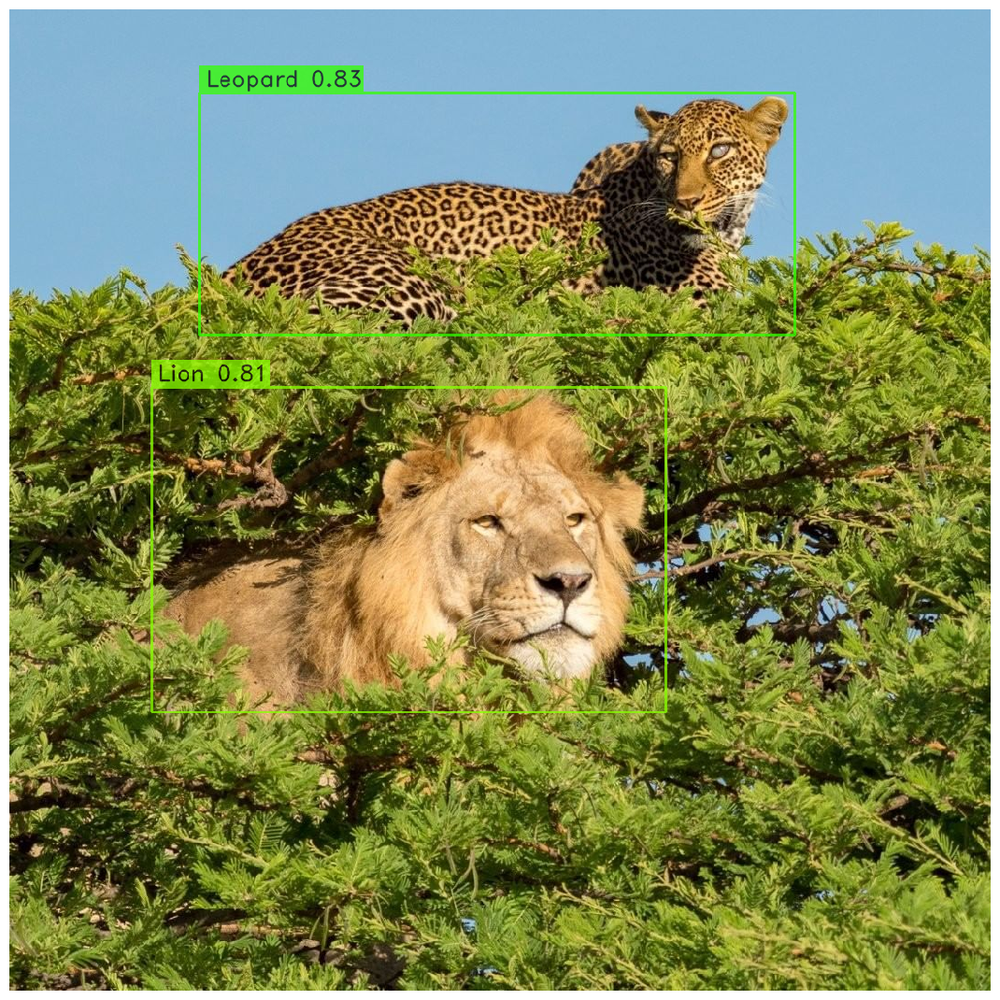

In [ ]:
# Predicting new data with 20 epochs
url = 'https://i.pinimg.com/1200x/da/8f/72/da8f729a05ad064830f30cc757d2d277.jpg'
# 'https://cdn.britannica.com/40/146340-050-297B2798/Leopard-tree-Kenya-Masai-Mara-National-Reserve.jpg'
# fig = '/content/n02085620_326.jpg'
best_model.predict(url).show()

[2023-08-28 08:38:50] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


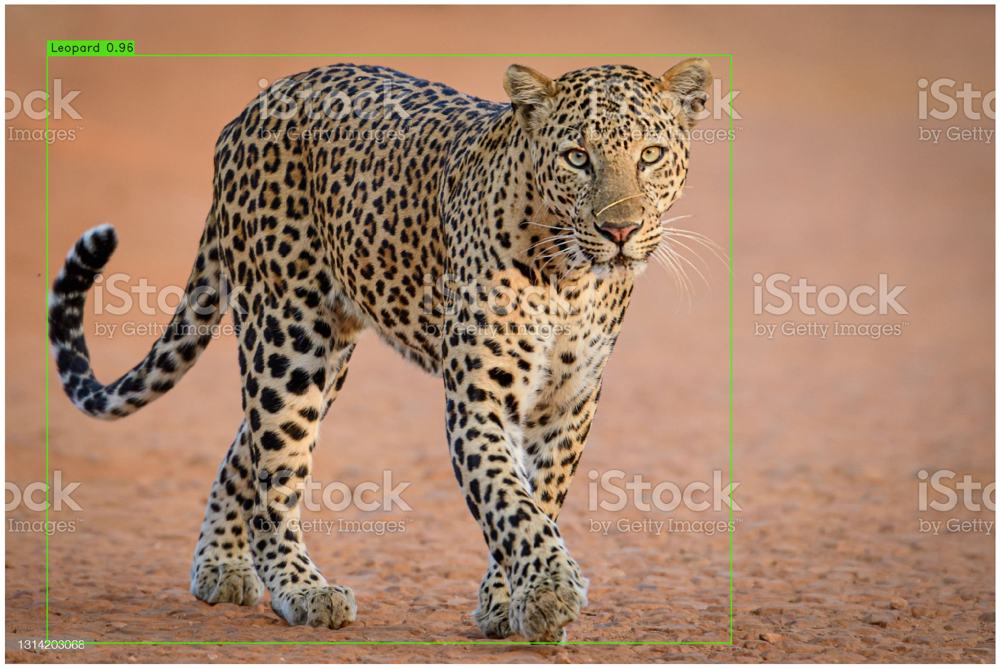

In [ ]:
best_model.predict('/content/leopard2.jpg').show()

/usr/local/lib/python3.10/dist-packages/torch/amp/autocast_mode.py:204: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn('User provided device_type of \'cuda\', but CUDA is not available. Disabling')
[2023-08-28 08:39:38] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


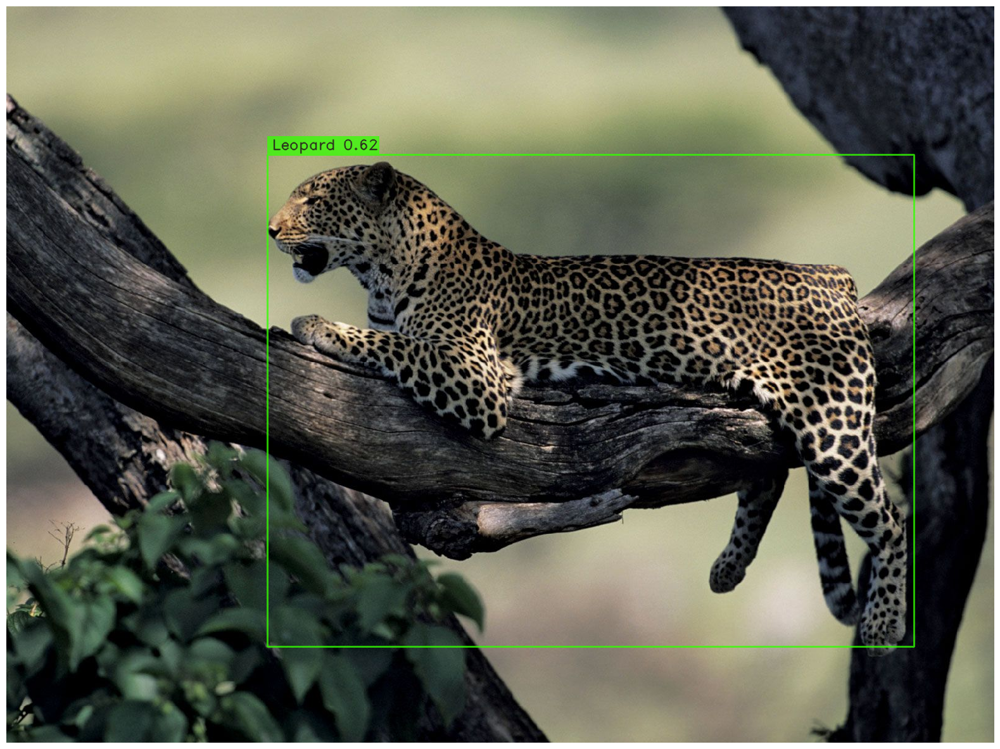

In [ ]:
best_model.predict('https://cdn.britannica.com/40/146340-050-297B2798/Leopard-tree-Kenya-Masai-Mara-National-Reserve.jpg').show()

[2023-08-28 08:40:53] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


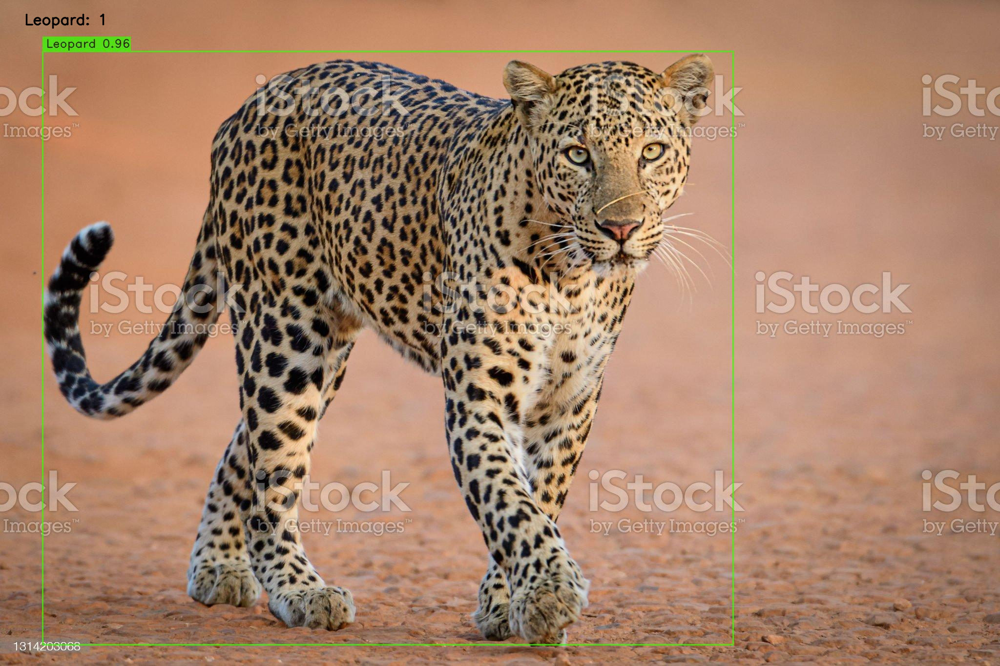

In [ ]:
# Saving the predicted image and gathering the details required
from collections import Counter
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
%matplotlib inline

from google.colab.patches import cv2_imshow

pred = best_model.predict('/content/leopard2.jpg')
# saving the predicted image
pred.save(output_folder="/content/output")

result = list(pred)[0]

class_names = list(result.class_names)

counter = Counter(list(result.prediction.labels.astype("int")))
output = list(counter.items())
output = list(map(lambda x: (class_names[x[0]],x[1]),output))

path = r'/content/output/pred_0.jpg'
image = cv2.imread(path)

# font = cv2.FONT_HERSHEY_SIMPLEX
# # org
# org = (50, 50)
# # fontScale
# fontScale = 1
# # Blue color in BGR
# color = (0,0,255)
# # Line thickness of 2 px
# thickness = 2


for i in range(len(output)):
  # Using cv2.putText() method
  org = (50, 50*i+50)
  image = cv2.putText(image, str(output[i][0]) + ': '+ str(output[i][1]), org, cv2.FONT_HERSHEY_SIMPLEX, 1, (0,0,0), 2, cv2.LINE_AA)

cv2_imshow(image)